<a href="https://colab.research.google.com/github/kmedard/C964-Computer-Science-Capstone/blob/main/tag_analyzer.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Introduction**
This Jupyter notebook serves as a proof of concept for a view count predictor. The first sections focus on setup and data processing. At the end of the notebook, you can test the predictive model. 

The first step is to introduce several libraries that help with model training.

# **Import Libraries**

In [20]:

!pip install tensorflow
!pip install tensorflow_addons

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [21]:
import numpy as np
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
from tqdm import tqdm
from ast import literal_eval
from sklearn.preprocessing import MultiLabelBinarizer
from sklearn.model_selection import train_test_split
from sklearn.decomposition import PCA
from sklearn.metrics import r2_score
import tensorflow as tf
import tensorflow_addons as tfa
from wordcloud import WordCloud
from PIL import Image
import matplotlib.pyplot as plt
import re

# **Import YouTube trending video dataset**
##  "Collected or available datasets"
Retrives records from csv file and puts them into data frame
Only retrieves categoryID, view_count, and tags

In [22]:
video_df = pd.read_csv('/content/US_youtube_trending_data.csv', usecols=['categoryId', 'view_count', 'tags'],engine='python', on_bad_lines='skip', header=0)
train_df = video_df

# **Featurizing, Parsing, Cleaning, and Wrangling Datasets**

In [23]:
# remove empty and/or incomplete rows
values = ['[None]',"[None]",'None']
train_df = train_df[train_df.tags.isin(values) == False]
train_df.dropna()
train_df = train_df.drop(train_df[train_df['tags'] == '[]'].index, axis=0).reset_index(drop=True)
train_df

,categoryId,tags,view_count
0,22,brawadis|prank|basketball|skits|ghost|funny vi...,1514614
1,20,Apex Legends|Apex Legends characters|new Apex ...,2381688
2,24,jacksepticeye|funny|funny meme|memes|jacksepti...,2038853
3,10,xxl freshman|xxl freshmen|2020 xxl freshman|20...,496771
4,26,The LaBrant Family|DIY|Interior Design|Makeove...,1123889
...,...,...,...
110674,10,GOT7|갓세븐|마크|제이비|잭슨|진영|영재|뱀뱀|유겸|아가새|IGOT7|GOT7 ...,17426711
110675,10,Harry Styles|As It Was|BBC|Radio|Live Lounge,1394349
110676,17,WWE|WWE Raw|WWE Raw Highlights|WWE Raw Highlig...,676655
110677,24,reel rejects|thor|thor love and thunder|thor l...,429757


In [24]:
# Remove non alphanumeric characters that are also not "|"
# Turn tags string into list of string items
train_df['tags'] = train_df['tags'].apply(lambda word_list: re.sub(r"[^a-zA-Z0-9|]", "",word_list.lower().replace(" ", "")).split('|'))
train_df

,categoryId,tags,view_count
0,22,"[brawadis, prank, basketball, skits, ghost, fu...",1514614
1,20,"[apexlegends, apexlegendscharacters, newapexle...",2381688
2,24,"[jacksepticeye, funny, funnymeme, memes, jacks...",2038853
3,10,"[xxlfreshman, xxlfreshmen, 2020xxlfreshman, 20...",496771
4,26,"[thelabrantfamily, diy, interiordesign, makeov...",1123889
...,...,...,...
110674,10,"[got7, , , , , , , , , , igot7, got7epgot7nana...",17426711
110675,10,"[harrystyles, asitwas, bbc, radio, livelounge]",1394349
110676,17,"[wwe, wweraw, wwerawhighlights, wwerawhighligh...",676655
110677,24,"[reelrejects, thor, thorloveandthunder, thorlo...",429757


# **Building Variables for Model**

In [25]:
y = train_df.loc[:, 'view_count']
X_raw = train_df.loc[:, 'tags']

In [26]:
X_raw

0         [brawadis, prank, basketball, skits, ghost, fu...
1         [apexlegends, apexlegendscharacters, newapexle...
2         [jacksepticeye, funny, funnymeme, memes, jacks...
3         [xxlfreshman, xxlfreshmen, 2020xxlfreshman, 20...
4         [thelabrantfamily, diy, interiordesign, makeov...
                                ...                        
110674    [got7, , , , , , , , , , igot7, got7epgot7nana...
110675       [harrystyles, asitwas, bbc, radio, livelounge]
110676    [wwe, wweraw, wwerawhighlights, wwerawhighligh...
110677    [reelrejects, thor, thorloveandthunder, thorlo...
110678    [howifeelaboutmylossannouncement, how, feel, a...
Name: tags, Length: 110679, dtype: object

In [27]:
word_counts = {}
stopwords = ['[None]', '',' ','[none]']
for word_list in X_raw:
    for word in word_list:
        if word not in stopwords:
            if word in word_counts:
                word_counts[word] += 1
            else:
                word_counts[word] = 1

In [28]:
word_counts_sorted = {key: value for key, value in sorted(word_counts.items(), key=lambda item: item[1], reverse=True)}
#word_counts_sorted

In [29]:
vocabulary = list(word_counts_sorted)[:500]
for word_list in X_raw:
    word_list[:] = [word for word in word_list if word in vocabulary]
X_raw

0         [prank, basketball, funnyvideos, vlog, vloggin...
1                               [apexlegends, battleroyale]
2         [funny, memes, reaction, react, trynottolaugh,...
3                    [nlechoppa, polog, rap, hiphop, music]
4                                                     [diy]
                                ...                        
110674                                                   []
110675                                                   []
110676                                                [wwe]
110677                                        [marvel, mcu]
110678                                  [fullfight, boxing]
Name: tags, Length: 110679, dtype: object

In [30]:
null_indices = set()

for i, words in tqdm(enumerate(X_raw)):
    if not words:
        null_indices.add(i)
X_raw = X_raw.drop(null_indices, axis=0).reset_index(drop=True)
y = y.drop(null_indices, axis=0).reset_index(drop=True)

110679it [00:00, 1491891.30it/s]


# Remove null rows and reset index

In [31]:
null_indices = set()
for i, words in tqdm(enumerate(X_raw)):
    if not words:
        null_indices.add(i)
word_column_names = []
for word_list in tqdm(X_raw):
    for word in word_list:
        if word not in word_column_names:
            word_column_names.append(word)

83362it [00:00, 1437610.53it/s]
100%|██████████| 83362/83362 [00:01<00:00, 56079.94it/s]


In [32]:
mlb = MultiLabelBinarizer()

X = pd.DataFrame(mlb.fit_transform(X_raw), columns=word_column_names)

In [33]:
X

,prank,basketball,funnyvideos,vlog,vlogging,nba,challenges,fazerug,apexlegends,battleroyale,...,grian,hermitcraft,minecraftmods,minecraft100days,fridaynightfunkin,mod,fnf,mcpe,spidermannowayhome,ukraine
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
83357,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
83358,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
83359,0,0,0,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
83360,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [34]:
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=0.2, random_state=24)
X.shape

(83362, 500)

# **Create and Train Data Model**

In [35]:
inputs = tf.keras.Input(shape=(500,))
x = tf.keras.layers.Dense(64, activation='relu')(inputs)
x = tf.keras.layers.Dense(64, activation='relu')(x)
outputs = tf.keras.layers.Dense(1, activation='linear')(x)

model = tf.keras.Model(inputs, outputs)


model.compile(
    optimizer='adam',
    loss='mean_squared_logarithmic_error'
)


batch_size = 20
epochs = 70

history = model.fit(
    X_train,
    y_train,
    validation_split=0.2,
    batch_size=batch_size,
    epochs=epochs,
    callbacks=[tf.keras.callbacks.ReduceLROnPlateau()]
)

Epoch 1/70
667/667 [==============================] - 3s 3ms/step - loss: 95.0386 - val_loss: 60.8916 - lr: 0.0010
Epoch 2/70
667/667 [==============================] - 3s 5ms/step - loss: 49.8250 - val_loss: 41.5747 - lr: 0.0010
Epoch 3/70
667/667 [==============================] - 4s 5ms/step - loss: 36.0854 - val_loss: 31.5736 - lr: 0.0010
Epoch 4/70
667/667 [==============================] - 3s 5ms/step - loss: 28.0246 - val_loss: 25.0209 - lr: 0.0010
Epoch 5/70
667/667 [==============================] - 4s 6ms/step - loss: 22.4398 - val_loss: 20.2430 - lr: 0.0010
Epoch 6/70
667/667 [==============================] - 2s 4ms/step - loss: 18.2372 - val_loss: 16.5419 - lr: 0.0010
Epoch 7/70
667/667 [==============================] - 2s 2ms/step - loss: 14.9258 - val_loss: 13.5779 - lr: 0.0010
Epoch 8/70
667/667 [==============================] - 2s 2ms/step - loss: 12.2452 - val_loss: 11.1568 - lr: 0.0010
Epoch 9/70
667/667 [==============================] - 2s 2ms/step - loss: 10.042

In [36]:
hist_fig = px.line(
    history.history,
    y=['loss', 'val_loss'],
    labels={'x': "Epoch", 'y': "Loss"},
    title="Loss Over Time"
)

hist_fig.show()

# **Outcome Accuarcy**

In [37]:
np.argmin(history.history['val_loss'])

69

In [38]:
model.evaluate(X_test, y_test)

2085/2085 [==============================] - 3s 1ms/step - loss: 0.9214


0.9213657379150391

In [39]:
y_preds = model.predict(X_test)
y_test

30041    15865147
83263     3435298
61175    14758421
18801     7215122
43687    16739525
           ...   
64183      748953
9880       780960
60504      252249
54040     3368256
55362      538687
Name: view_count, Length: 66690, dtype: int64

In [40]:
#Determine Accuracy
# 1 is excelent
r2_score(y_test, model.predict(X_test))

0.04404682530847448

In [41]:
pca = PCA(n_components=2)
X_reduced = pd.DataFrame(pca.fit_transform(X), columns=["PC1", "PC2"])
word_lists = []

for row in X_reduced.iterrows():
    word_list = [word for word in X.columns if X.loc[row[0], word] == 1]
    word_lists.append(word_list)
X_reduced['keywords'] = word_lists
X_reduced['keywords'] = X_reduced['keywords'].astype(str)

# **Non-Descriptive / Analytics**
Tags are organized by highest average views of videos accosiated with this tag

In [42]:
# convert dictionary to dataframe
word_count_df = pd.DataFrame(list(word_counts_sorted.items()), columns = ['tag','frequency'])
word_count_df = word_count_df.head(500)
word_count_df['tags'] = word_count_df.tag
word_count_df = word_count_df.merge(train_df.explode('tags'),how='left')
word_count_df['view_avg'] = word_count_df.groupby('tag')['view_count'].transform('mean')
del word_count_df['tags']
word_count_df.sort_values('view_avg')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,tag,frequency,categoryId,view_count,view_avg
300370,foxsports1,441,17,279231,5.854063e+05
300209,foxsports1,441,17,389158,5.854063e+05
300210,foxsports1,441,17,401439,5.854063e+05
300211,foxsports1,441,17,416198,5.854063e+05
300212,foxsports1,441,17,427484,5.854063e+05
...,...,...,...,...,...
355970,yg,343,10,3498001,1.897089e+07
355969,yg,343,10,3200306,1.897089e+07
355968,yg,343,10,4296129,1.897089e+07
355976,yg,343,10,4038080,1.897089e+07


In [43]:
corrMap = word_count_df.corr()
category_fig  = go.Figure()
category_fig.add_trace(
    go.Heatmap(
        x = corrMap.columns,
        y = corrMap.index,
        z = np.array(corrMap),
        text=corrMap.values,
        texttemplate='%{text:.2f}'
    )
)
category_fig.show()

In [44]:
scatter_fig = px.scatter(
    X_reduced,
    x='PC1',
    y='PC2',
    trendline="ols",
    hover_data={
        'PC1': False,
        'PC2': False,
        'keywords': True
    }
)
scatter_fig.show("notebook")

/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning:

pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.



# **Descriptive Methods / Data Visualization**

In [45]:
word_count_fig  = px.scatter(word_count_df, x="view_avg",y="tag")
word_count_fig.show()

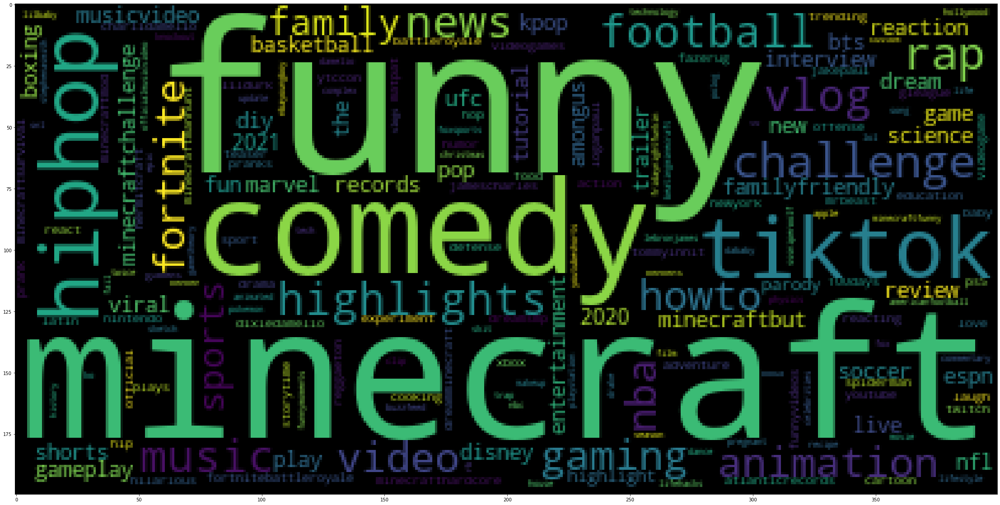

In [46]:
wc = WordCloud().generate_from_frequencies(word_counts_sorted)

plt.figure(figsize=(100,20))
plt.subplot(1,2,1)
plt.imshow(wc)

# **Interactive Dashboard**

In [47]:
# importing the module
import json
 
# Opening JSON file

with open('/content/US_category_id.json') as json_file:
    categories = json.load(json_file)["items"]
cat_dict = {}
for cat in categories:
    cat_dict[int(cat["id"])] = cat["snippet"]["title"]
word_count_df['category_name'] = word_count_df['categoryId'].map(cat_dict)
word_count_df

,tag,frequency,categoryId,view_count,view_avg,category_name
0,funny,9268,24,2038853,2.370174e+06,Entertainment
1,funny,9268,22,591837,2.370174e+06,People & Blogs
2,funny,9268,23,1561146,2.370174e+06,Comedy
3,funny,9268,23,8721068,2.370174e+06,Comedy
4,funny,9268,22,276232,2.370174e+06,People & Blogs
...,...,...,...,...,...,...
366908,famous,327,24,2684597,3.402490e+06,Entertainment
366909,famous,327,24,3611485,3.402490e+06,Entertainment
366910,famous,327,24,1871805,3.402490e+06,Entertainment
366911,famous,327,24,4073025,3.402490e+06,Entertainment


In [95]:
#Select Catergory
print("{:<8} {:<15}".format('ID','Category'))
print("----------------------------------")
for k, v in cat_dict.items():
  print("{:<8} {:<15}".format(k, v))

cat_choice = input ("Enter Category Id:")
print(cat_choice)


ID       Category       
----------------------------------
1        Film & Animation
2        Autos & Vehicles
10       Music          
15       Pets & Animals 
17       Sports         
18       Short Movies   
19       Travel & Events
20       Gaming         
21       Videoblogging  
22       People & Blogs 
23       Comedy         
24       Entertainment  
25       News & Politics
26       Howto & Style  
27       Education      
28       Science & Technology
29       Nonprofits & Activism
30       Movies         
31       Anime/Animation
32       Action/Adventure
33       Classics       
34       Comedy         
35       Documentary    
36       Drama          
37       Family         
38       Foreign        
39       Horror         
40       Sci-Fi/Fantasy 
41       Thriller       
42       Shorts         
43       Shows          
44       Trailers       
Enter Category Id:1
1


In [ ]:
#tag 1
print("{:<8} {:<15}".format('ID','Tag'))
print("----------------------------------")
tag1_filter = [] 
i = 0
for index, row in word_count_df[word_count_df['categoryId'] == int(cat_choice)].iterrows(): 
   if row["tag"] not in tag1_filter: 
     if row["tag"] in vocabulary:
        tag1_filter.append(row["tag"])
        print(str(i) + "\t\t"+row["tag"])
        i+=1
tag1_choice = input ("Enter tag id number:")       
tag1_choice = tag1_filter[int(tag1_choice)] 


In [150]:
#tag 2
print("{:<8} {:<15}".format('ID','Tag'))
print("----------------------------------")
tag2_filter = [] 
i = 0
for index, row in word_count_df[word_count_df['categoryId'] == int(cat_choice)].iterrows(): 
   if row["tag"] not in tag2_filter: 
     if row["tag"] in vocabulary:
       if row["tag"] is not tag1_choice:
        tag2_filter.append(row["tag"])
        print(str(i) + "\t\t"+row["tag"])
        i+=1
tag2_choice = input ("Enter tag id number:")       
tag2_choice = tag2_filter[int(tag2_choice)] 
     




ID       Tag            
----------------------------------
0		funny
1		minecraft
2		comedy
3		tiktok
4		hiphop
5		challenge
6		rap
7		vlog
8		music
9		gaming
10		animation
11		fortnite
12		howto
13		family
14		familyfriendly
15		new
16		reaction
17		trailer
18		game
19		kpop
20		diy
21		live
22		fun
23		musicvideo
24		2020
25		review
26		dream
27		bts
28		entertainment
29		2021
30		interview
31		disney
32		marvel
33		play
34		viral
35		tutorial
36		amongus
37		parody
38		mrbeast
39		food
40		official
41		nintendo
42		spiderman
43		videogames
44		charlidamelio
45		games
46		lildurk
47		meme
48		dixiedamelio
49		humor
50		youtube
51		trending
52		prank
53		jamescharles
54		action
55		cartoon
56		battleroyale
57		teaser
58		memes
59		hilarious
60		videogame
61		baby
62		experiment
63		cooking
64		adventure
65		fazerug
66		pranks
67		loganpaul
68		love
69		jakepaul
70		matpat
71		ps5
72		newyork
73		storytime
74		drama
75		xbox
76		fridaynightfunkin
77		lilbaby
78		animated
79		fail
80		p

In [151]:
#tag 3
print("{:<8} {:<15}".format('ID','Tag'))
print("----------------------------------")
tag3_filter = [] 
for index, row in word_count_df[word_count_df['categoryId'] == int(cat_choice)].iterrows(): 
  if row["tag"] in vocabulary:
   if row["tag"] not in tag3_filter: 
     if row["tag"] is not tag2_choice:
       if row["tag"] is not tag1_choice:
         tag3_filter.append(row["tag"])
         print(str(i) + "\t\t"+row["tag"])
         i+=1
tag3_choice = input ("Enter tag id number:")       
tag3_choice = tag3_filter[int(tag3_choice)] 

ID       Tag            
----------------------------------
216		funny
217		minecraft
218		tiktok
219		hiphop
220		challenge
221		rap
222		vlog
223		music
224		gaming
225		animation
226		fortnite
227		howto
228		family
229		familyfriendly
230		new
231		reaction
232		trailer
233		game
234		kpop
235		diy
236		live
237		fun
238		musicvideo
239		2020
240		review
241		dream
242		bts
243		entertainment
244		2021
245		interview
246		disney
247		marvel
248		play
249		viral
250		tutorial
251		amongus
252		parody
253		mrbeast
254		food
255		official
256		nintendo
257		spiderman
258		videogames
259		charlidamelio
260		games
261		lildurk
262		meme
263		dixiedamelio
264		humor
265		youtube
266		trending
267		prank
268		jamescharles
269		action
270		cartoon
271		battleroyale
272		teaser
273		memes
274		hilarious
275		videogame
276		baby
277		experiment
278		cooking
279		adventure
280		fazerug
281		pranks
282		loganpaul
283		love
284		jakepaul
285		matpat
286		ps5
287		newyork
288		storytime
289		dra

In [158]:

prediction1 = model.predict([X[X[tag1_filter[0]]== 1].iloc[0].tolist()])
prediction2 = model.predict([X[X[tag2_filter[0]]== 1].iloc[0].tolist()])
prediction3 = model.predict([X[X[tag3_filter[0]]== 1].iloc[0].tolist()])
average = (prediction1[0][0]+ prediction2[0][0]+prediction3[0][0])/3
print("Estimatation is that the video will recieve:\n\t"+str(int(average)) + " views")

Estimatation is that the video will recieve:
	1980499 views
